<a href="https://colab.research.google.com/github/all-alli90/Mendeley-Diabetes-Dataset/blob/main/Predictive_Modeling_of_Diabetes_using_Decision_Tree%2C_K_NN_and_Logistic_Regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Predictive Modeling of Diabetes Using Decision Trees, K-Nearest Neighbour and Logistic Regression**

In [ ]:
import pandas as pd
from scipy.io import arff
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
!pip install ydata-profiling
from ydata_profiling import ProfileReport

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Dataset of Diabetes .csv to Dataset of Diabetes  (2).csv


In [ ]:
df = pd.read_csv("Dataset of Diabetes .csv")
df

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y


# Cleaning Dataset

In [ ]:
#renamed columns to remove capitalization, correct spelling and have overall consistency

df.columns = ['id', 'no_patient', 'gender', 'age', 'urea', 'cr',
              'hba1c', 'chol', 'tg', 'hdl',
              'ldl', 'vldl', 'bmi', 'class']

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          1000 non-null   int64  
 1   no_patient  1000 non-null   int64  
 2   gender      1000 non-null   object 
 3   age         1000 non-null   int64  
 4   urea        1000 non-null   float64
 5   cr          1000 non-null   int64  
 6   hba1c       1000 non-null   float64
 7   chol        1000 non-null   float64
 8   tg          1000 non-null   float64
 9   hdl         1000 non-null   float64
 10  ldl         1000 non-null   float64
 11  vldl        1000 non-null   float64
 12  bmi         1000 non-null   float64
 13  class       1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


In [ ]:
#checking for missing values

print(df.isnull().sum())

id            0
no_patient    0
gender        0
age           0
urea          0
cr            0
hba1c         0
chol          0
tg            0
hdl           0
ldl           0
vldl          0
bmi           0
class         0
dtype: int64


In [ ]:
#checking for duplicate values in id column

duplicate_id = df['id'].duplicated().sum()
duplicate_id

200

In [ ]:
#identifying the duplicate id vlaues

duplicate_num_id = df['id'].value_counts()
duplicate_num_id = duplicate_num_id[duplicate_num_id > 1]
print(duplicate_num_id)

id
76     2
108    2
57     2
26     2
69     2
      ..
150    2
49     2
144    2
145    2
147    2
Name: count, Length: 200, dtype: int64


In [ ]:
#Random sample #1 - Checking if the ids are duplicate values only or duplicate patient record.
#Since the other columns have different values, this might be just duplicate values only.

display(df[df['id'] == 76])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,class
249,76,9903,M,73,4.3,79,6.0,5.3,1.4,1.5,3.2,0.6,27.0,Y
910,76,8978,M,60,5.4,64,10.4,3.8,1.5,0.8,2.3,0.6,31.0,Y


In [ ]:
#Random sample #2

display(df[df['id'] == 150])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,class
88,150,45382,F,40,6.3,79,4.9,4.3,0.8,0.8,1.8,1.2,22.0,N
184,150,34287,F,42,2.8,39,4.6,4.7,2.5,1.3,2.4,1.1,25.0,Y


In [ ]:
#checking for duplicate values in patient number column

duplicate_no_patient = df['no_patient'].duplicated().sum()
duplicate_no_patient

39

In [ ]:
#identifying the duplicate patient numbers

duplicate_num_patient = df['no_patient'].value_counts()
duplicate_num_patient = duplicate_num_patient[duplicate_num_patient > 1]
print(duplicate_num_patient)

no_patient
454316    19
856        2
87654      2
71741      2
34290      2
14389      2
34517      2
48362      2
45646      2
44835      2
24033      2
34514      2
23972      2
34325      2
234        2
45370      2
34516      2
34518      2
2345       2
34515      2
34545      2
345        2
Name: count, dtype: int64


In [ ]:
#Random sample #1 - Checking if the patient number are duplicate values only or duplicate patient record.
#Since the other columns have different values, this might be just duplicate values only.

display(df[df['no_patient'] == 45646])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,class
936,111,45646,F,63,4.7,55,12.60,7.9,5.0,1.3,2.1,0.7,35.0,Y
938,113,45646,F,55,2.1,23,9.96,4.1,4.2,1.2,1.4,1.3,29.0,Y


In [ ]:
#Random sample #2

display(df[df['no_patient'] == 34290])

,id,no_patient,gender,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi,class
34,699,34290,F,47,5.6,67,5.1,6.5,1.5,0.9,4.9,0.7,23.0,N
260,510,34290,M,73,4.3,79,6.9,5.3,1.4,1.5,3.2,0.6,28.0,Y


In [ ]:
#checking the gender column

gender_frequency = df['gender'].value_counts()
print(gender_frequency)

gender
M    565
F    434
f      1
Name: count, dtype: int64


In [ ]:
#Converting the lowercase f to uppercase and updating the gender_frequency variable

df['gender'] = df['gender'].replace({'f': 'F'})
gender_frequency = df['gender'].value_counts()
print(gender_frequency)

gender
M    565
F    435
Name: count, dtype: int64


In [ ]:
#checking the class column

class_frequency = df['class'].value_counts()
print(class_frequency)

class
Y     840
N     102
P      53
Y       4
N       1
Name: count, dtype: int64


In [ ]:
#There is a space trailing after some of the Y and N values (eg: 'Y ' and 'N '). This is causing the data to be read as different values.
#The below converts these values to Y and N respectively

df['class'] = df['class'].replace({'N ': 'N', 'Y ': 'Y'})
class_frequency = df['class'].value_counts()
print(class_frequency)

class
Y    844
N    103
P     53
Name: count, dtype: int64


# Initial Analysis


In [ ]:
#Statistical summary of the attributes

df.describe()

,id,no_patient,age,urea,cr,hba1c,chol,tg,hdl,ldl,vldl,bmi
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


The average age of the patients in the dataset is 53.53, suggeting the population is mostly middle age. The creatinine variable has a large standard deviation (59.98) and a large range (from 6 to 800), suggesting the presence of extreme values.

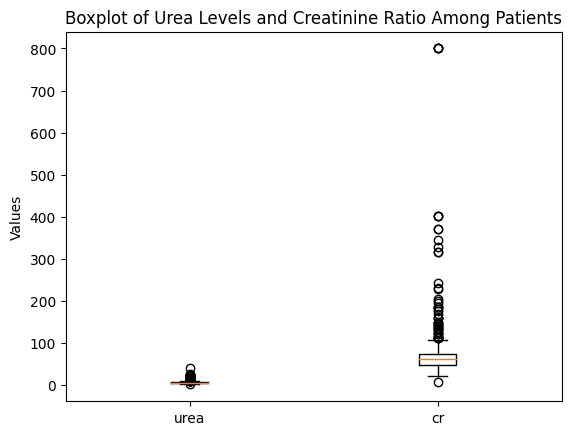

In [ ]:
#Observing distribution of values in Urea and Creatinine

plt.boxplot(df[['urea','cr']])
plt.title('Boxplot of Urea Levels and Creatinine Ratio Among Patients')

plt.xticks([1, 2], ['urea','cr'])
plt.ylabel("Values")

plt.show()

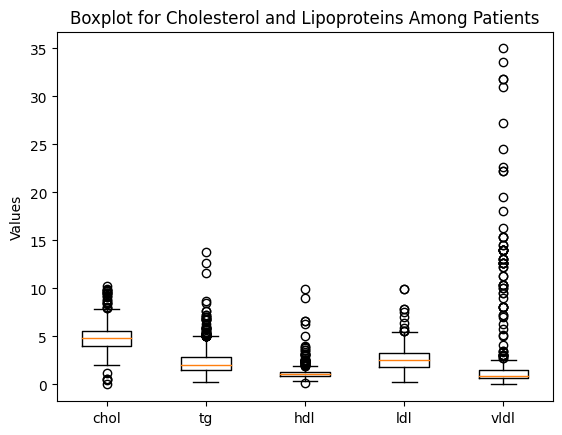

In [ ]:
#Observing distribution of values in Urea and Creatinine

plt.boxplot(df[['chol','tg','hdl','ldl','vldl']])
plt.title('Boxplot for Cholesterol and Lipoproteins Among Patients')

plt.xticks([1, 2, 3, 4, 5], ['chol','tg','hdl','ldl','vldl'])
plt.ylabel("Values")

plt.show()

There are noticeable outliers present in the cholesterol, lipoprotein, urea, and creatinine attributes. This suggests that several patients may have extreme values for these attributes.

Urea and creatinine ration are clinical measurements used to assess kidney impairment. While cholestrol, the lipoproteins and trtriglycerides levels are used to determine cardiovascular damage. These outliers therefore suggests there may be patients with kidney and cardiovascular damage.

In [ ]:
#Using Panda Profile Report for further analysis

report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Report confirms there are no missing values or duplicate rows within the dataset.


Both HbA1c and Cholesterol exhibit a normal bell shaped distribution, indicating a relatively even spread of data around the mean. The other features appear skewed, suggesting that their data distributions are more concentrated around certain values, and the presence of outliers.  

Cholesterol, triglycerides, HLDL and LDL have variances below 2, with the lowest being 0.44 for the HLDL variable. This suggests that these variables exhibit small spread with most of the values being close to the mean.

There are several correlations obsevered among the variable. Triglycerides(tg) has a high positive correlation with vldl (0.599), and creatinine has a high positive correlation with urea (0.568). BMI exhibits moderately positive correlation with a coefficient of 0.417, suggesting elevaated HbA1c levels are associated with BMI.

The target variable, class, has a strong positive correlation with bmi (0.549) and hba1c (0.662). This suggests that both bmi and hba1c are influential and important in determining the likelihood of diabetes.


There is a significant class imbalance with 844 individuals classified as diabetic, 103 as non-diabetic, and only 53 as pre-diabetic. This 51.5% imbalance may affect the performance of the predictive algorithms leading to bias towards the majority class.

# Visualization

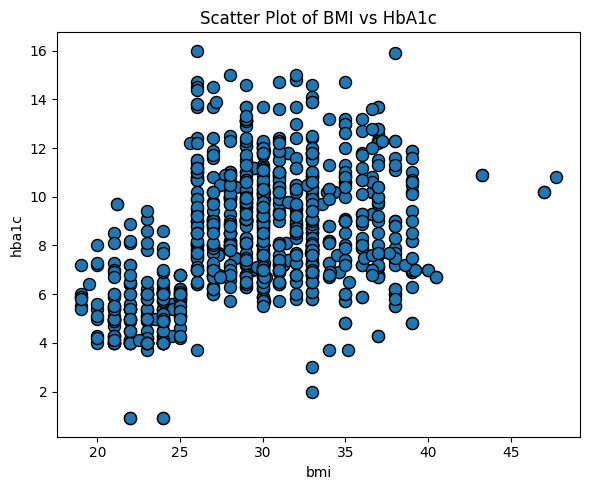

In [ ]:
#Graph showing relationship between BMI and Glusoce

plt.figure(figsize=(6, 5))
plt.scatter(df['bmi'], df['hba1c'], s=75, edgecolor='k')

plt.title('Scatter Plot of BMI vs HbA1c')
plt.xlabel('bmi')
plt.ylabel('hba1c')
plt.tight_layout()
plt.show()

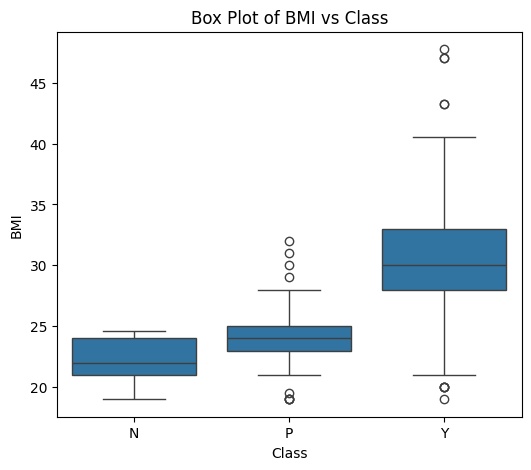

In [ ]:
#Graph showing relationship between BMI and Class

plt.figure(figsize=(6, 5))
sns.boxplot(x='class', y='bmi', data=df)
plt.title('Box Plot of BMI vs Class')
plt.xlabel('Class')
plt.ylabel('BMI')
plt.show()

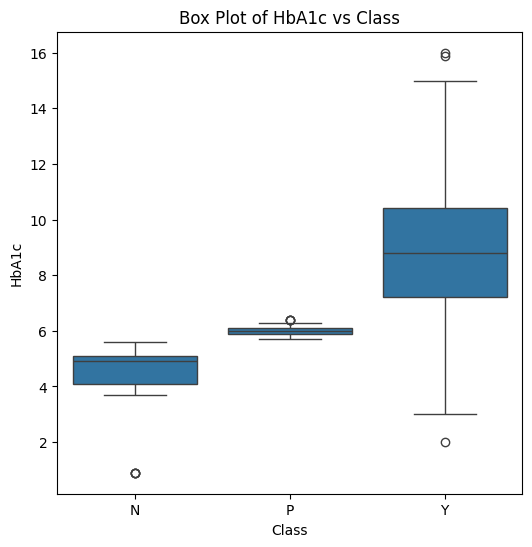

In [ ]:
#Graph showing relationship between BMI and Class

plt.figure(figsize=(6, 6))
sns.boxplot(x='class', y='hba1c', data=df)
plt.title('Box Plot of HbA1c vs Class')
plt.xlabel('Class')
plt.ylabel('HbA1c')
plt.show()